In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
pd.set_option('display.max_columns', None)

In [5]:
# Load your dataset
df = pd.read_csv('/content/drive/MyDrive/pro/res_apart_S.csv')

In [6]:
df = df.drop(columns=['Unnamed: 0'])

In [7]:
df.head()

,preference,description,city,locality,prop_name,own_type,#bedroom,#balcony,furnish,facing,possesion_age,floor_num,#floors,area_in_sqft,price_in_sqft,price_in_lakh,transaction_type,latitude,longitude,total_landmark_count,connectivity,hospital+pharmacy,religious_places,education,banks,shoppings,office_complexes,luxury_score
0,S,4 bhk flat for resale in alpha corp gurgaon one,Gurgaon,Sector 84,Alpha Corp GurgaonOne 84,Freehold,4.0,4.0,Semifurnished,North,5-10 Year Old Property,14,26,3434,8766,263.0,1.0,28.406534,76.962792,10.0,0,1,0,2,1,4,0,82.0
1,S,"Explore dlf ultima, an upscale ready-To-Move h...",Gurgaon,Sector 81,DLF The Ultima,Freehold,4.0,3.0,Semifurnished,North,1-5 Year Old Property,7,29,2870,21176,360.0,1.0,28.388907,76.951328,9.0,5,1,0,2,0,1,0,112.0
2,S,Looking for a 3 bhk property for purchase in g...,Gurgaon,Sector 112,Experion Windchants,Freehold,3.0,3.0,Semifurnished,NaN,1-5 Year Old Property,14,28,2802,13740,385.0,1.0,28.518677,77.015115,8.0,3,2,0,2,0,1,0,89.0
3,S,Ats triumph is one of gurgaon's most sought af...,Gurgaon,Sector 104,ATS Triumph,Freehold,3.0,4.0,Semifurnished,South,1-5 Year Old Property,4,27,2290,8515,195.0,1.0,28.478440,76.986110,14.0,5,1,0,3,0,1,1,75.0
4,S,Check out this 2 bhk apartment for sale in m3m...,Gurgaon,Sector 74,M3M Skywalk,Freehold,2.0,3.0,Unfurnished,East,0-1 Year Old Property,12,30,1400,11571,162.0,1.0,28.416400,77.012620,13.0,4,1,0,2,0,1,1,52.0


# **Price VS**

In [14]:
df[df['area_in_sqft']>10000]['area_in_sqft'].shape

(35,)

<Axes: xlabel='area_in_sqft', ylabel='price_in_lakh'>

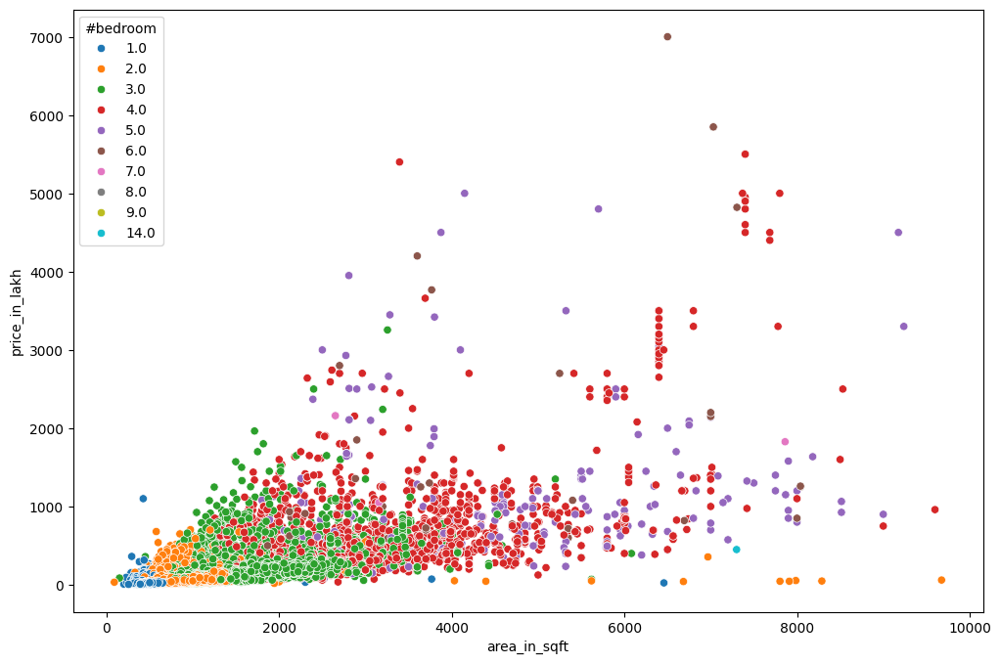

In [16]:
plt.figure(figsize=(12,8))
sns.scatterplot(data=df,x=df[df['area_in_sqft']<10000]['area_in_sqft'],y=df['price_in_lakh'],hue=df['#bedroom'].astype('category'))

<Axes: xlabel='area_in_sqft', ylabel='price_in_lakh'>

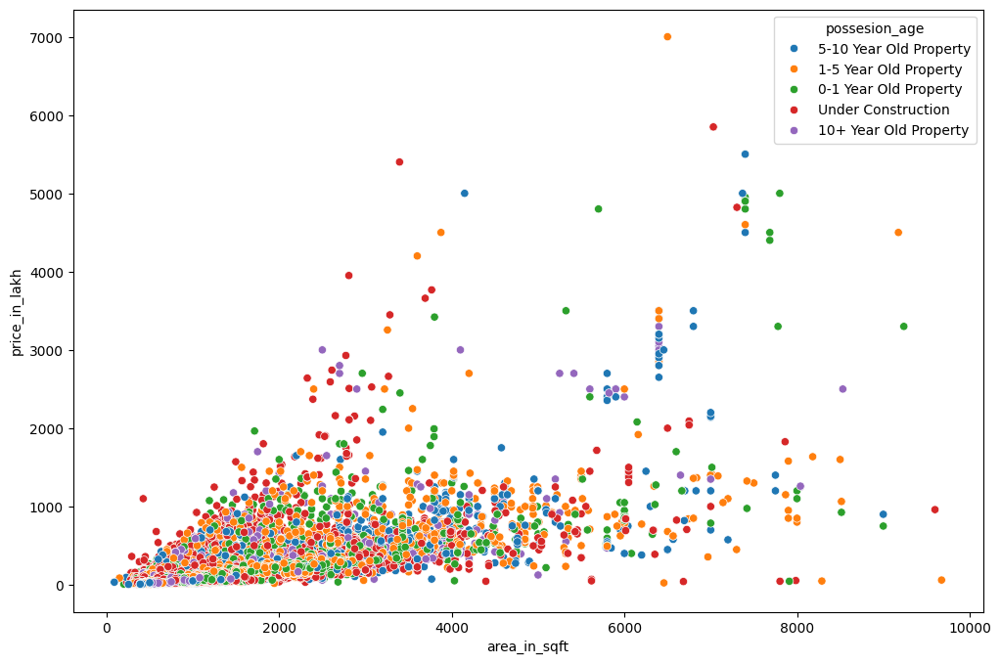

In [11]:
plt.figure(figsize=(12,8))
sns.scatterplot(data=df,x=df[df['area_in_sqft']<10000]['area_in_sqft'],y=df['price_in_lakh'],hue=df['possesion_age'])

<Axes: xlabel='area_in_sqft', ylabel='price_in_lakh'>

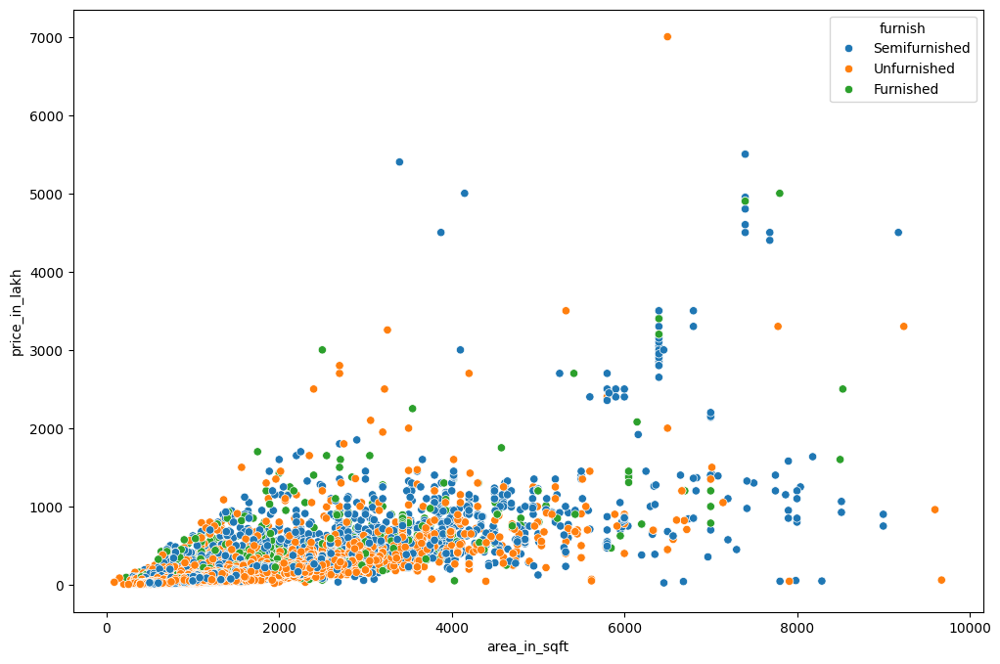

In [15]:
plt.figure(figsize=(12,8))
sns.scatterplot(data=df,x=df[df['area_in_sqft']<10000]['area_in_sqft'],y=df['price_in_lakh'],hue=df['furnish'])

<Axes: xlabel='#bedroom', ylabel='price_in_lakh'>

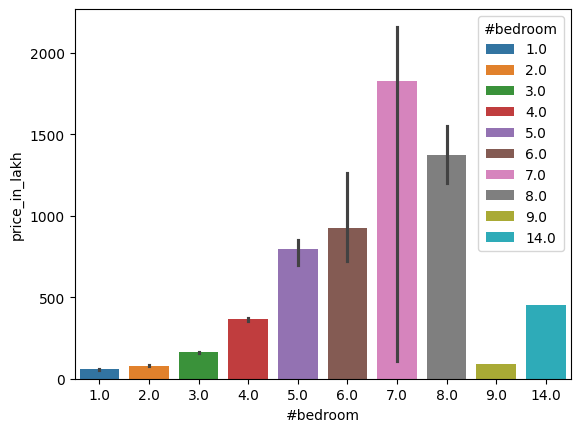

In [21]:
sns.barplot(x=df['#bedroom'],y=df['price_in_lakh'],estimator=np.median,hue=df['#bedroom'].astype('category'))

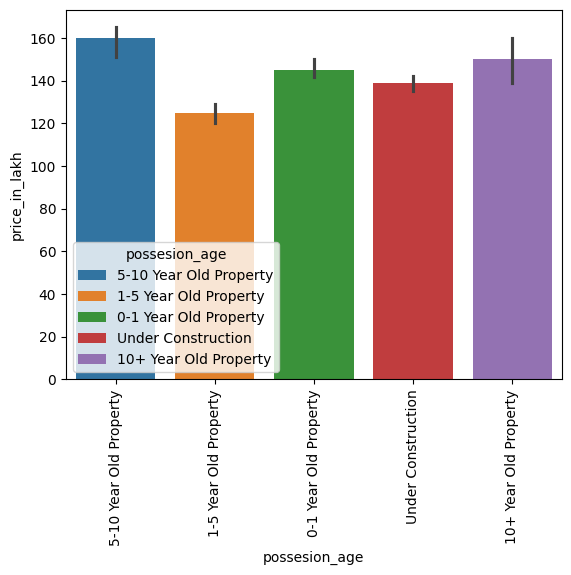

In [23]:
sns.barplot(x=df['possesion_age'],y=df['price_in_lakh'],estimator=np.median,hue=df['possesion_age'])
plt.xticks(rotation='vertical')
plt.show()

<Axes: xlabel='furnish', ylabel='price_in_lakh'>

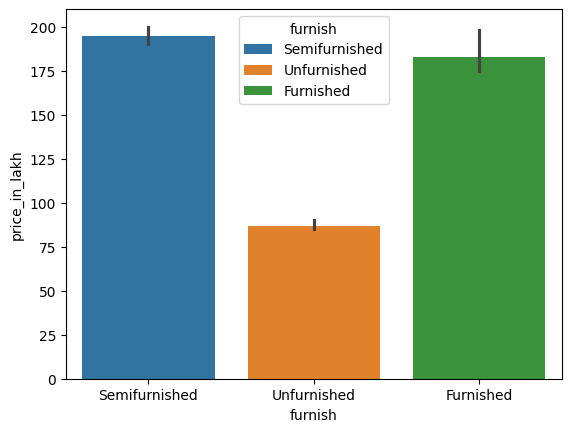

In [24]:
sns.barplot(x=df['furnish'],y=df['price_in_lakh'],estimator=np.median,hue=df['furnish'])

<Axes: xlabel='luxury_score', ylabel='price_in_lakh'>

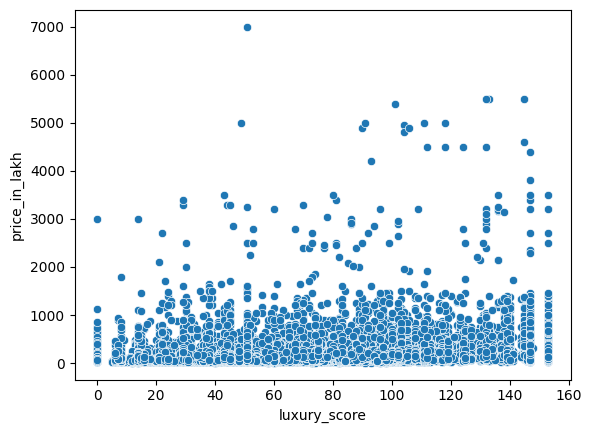

In [27]:
sns.scatterplot(data=df,x=df['luxury_score'],y=df['price_in_lakh'])

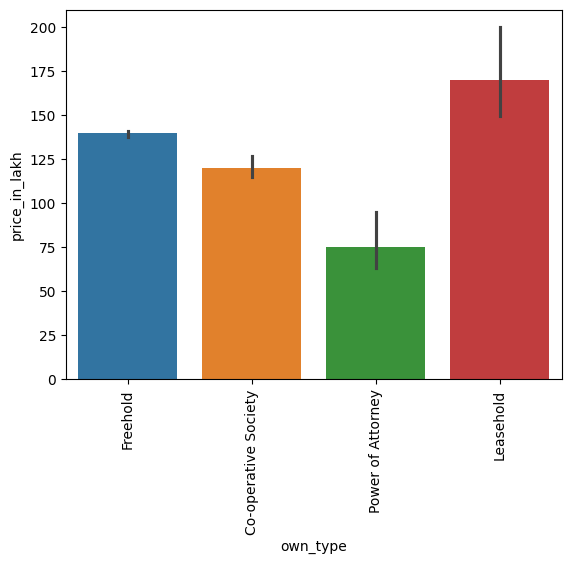

In [30]:
sns.barplot(x=df['own_type'],y=df['price_in_lakh'],estimator=np.median,hue=df['own_type'])
plt.xticks(rotation='vertical')
plt.show()

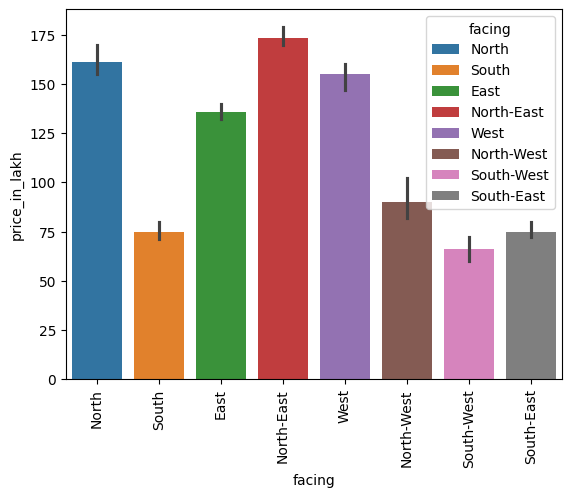

In [31]:
sns.barplot(x=df['facing'],y=df['price_in_lakh'],estimator=np.median,hue=df['facing'])
plt.xticks(rotation='vertical')
plt.show()

# **Price/sqft VS**

<Axes: xlabel='area_in_sqft', ylabel='price_in_sqft'>

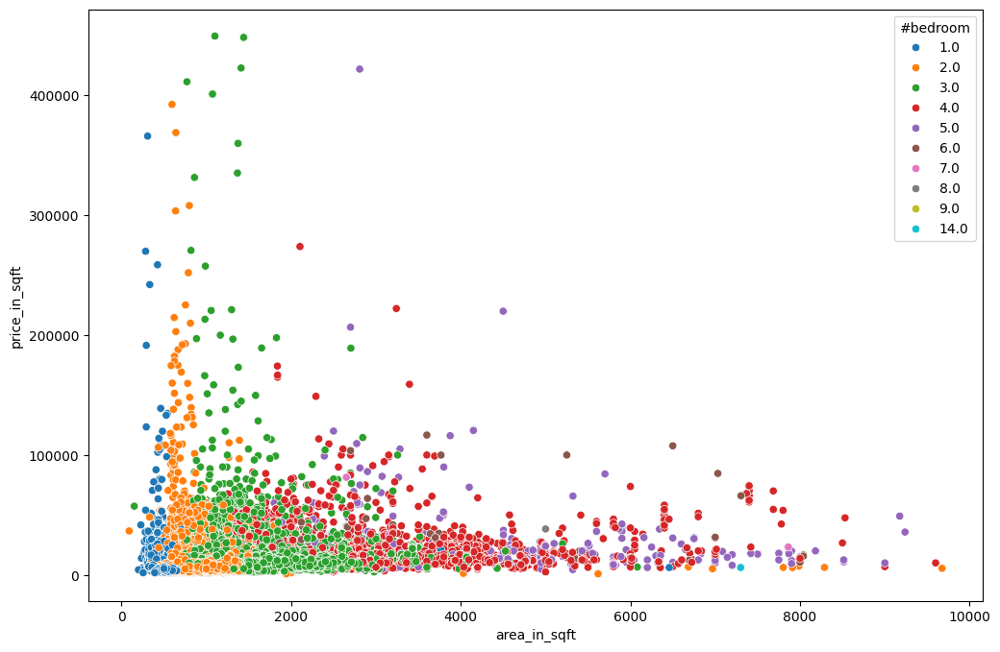

In [9]:
plt.figure(figsize=(12,8))
sns.scatterplot(data=df,x=df[df['area_in_sqft']<10000]['area_in_sqft'],y=df['price_in_sqft'],hue=df['#bedroom'].astype('category'))

<Axes: xlabel='area_in_sqft', ylabel='price_in_sqft'>

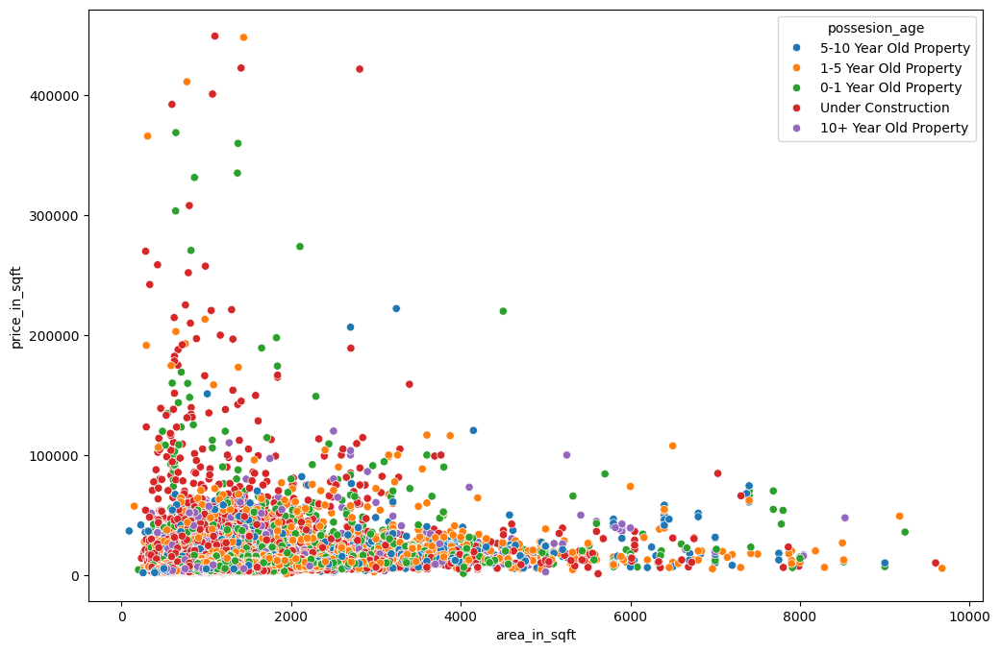

In [11]:
plt.figure(figsize=(12,8))
sns.scatterplot(data=df,x=df[df['area_in_sqft']<10000]['area_in_sqft'],y=df['price_in_sqft'],hue=df['possesion_age'])

<Axes: xlabel='area_in_sqft', ylabel='price_in_sqft'>

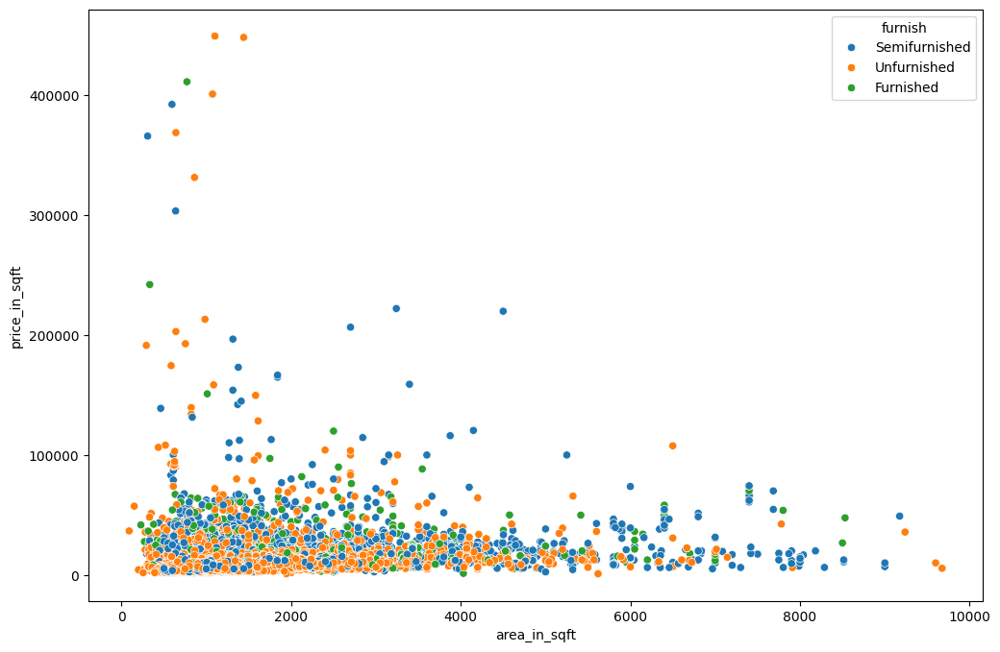

In [12]:
plt.figure(figsize=(12,8))
sns.scatterplot(data=df,x=df[df['area_in_sqft']<10000]['area_in_sqft'],y=df['price_in_sqft'],hue=df['furnish'])

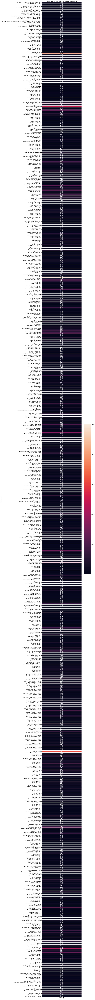

In [42]:
# Combine 'locality' and 'city' columns
df['locality_city'] = df['locality'] + ', ' + df['city']

# Group by 'locality_city' and calculate the average price
avg_price_per_locality = df.groupby('locality_city')['price_in_lakh'].mean().reset_index()

# Sort by 'locality_city' alphabetically
avg_price_per_locality_sorted = avg_price_per_locality.sort_values(by='locality_city')

# Plot the heatmap
plt.figure(figsize=(10, 200))
sns.heatmap(avg_price_per_locality_sorted.set_index('locality_city')[['price_in_lakh']], annot=True, fmt=".2f", linewidths=0.5)
plt.title('Average Price per Locality and City (Sorted Alphabetically)')
plt.xlabel('Average Price')
plt.ylabel('Locality, City')
plt.show()

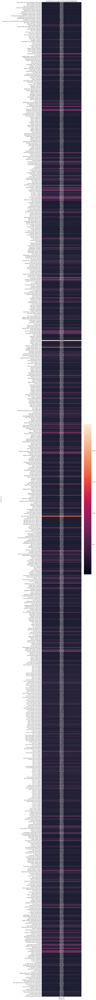

In [40]:
# Combine 'locality' and 'city' columns
df['locality_city'] = df['locality'] + ', ' + df['city']

# Group by 'locality_city' and calculate the average price
avg_price_per_locality = df.groupby('locality_city')['price_in_sqft'].mean().reset_index()

# Sort by 'locality_city' alphabetically
avg_price_per_locality_sorted = avg_price_per_locality.sort_values(by='locality_city')

# Plot the heatmap
plt.figure(figsize=(10, 200))
sns.heatmap(avg_price_per_locality_sorted.set_index('locality_city')[['price_in_sqft']], annot=True, fmt=".2f", linewidths=.5)
plt.title('Average Price per Locality and City (Sorted Alphabetically)')
plt.xlabel('Average Price')
plt.ylabel('Locality, City')
plt.show()

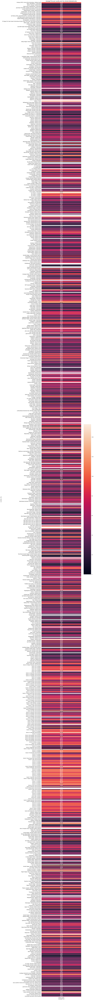

In [47]:
# Combine 'locality' and 'city' columns
df['locality_city'] = df['locality'] + ', ' + df['city']

# Group by 'locality_city' and calculate the average price
avg_price_per_locality = df.groupby('locality_city')['luxury_score'].mean().reset_index()

# Sort by 'locality_city' alphabetically
avg_price_per_locality_sorted = avg_price_per_locality.sort_values(by='locality_city')

# Plot the heatmap
plt.figure(figsize=(10, 200))
sns.heatmap(avg_price_per_locality_sorted.set_index('locality_city')[['luxury_score']], annot=True, fmt=".2f", linewidths=.5)
plt.title('Average Price per Locality and City (Sorted Alphabetically)')
plt.xlabel('Average Price')
plt.ylabel('Locality, City')
plt.show()

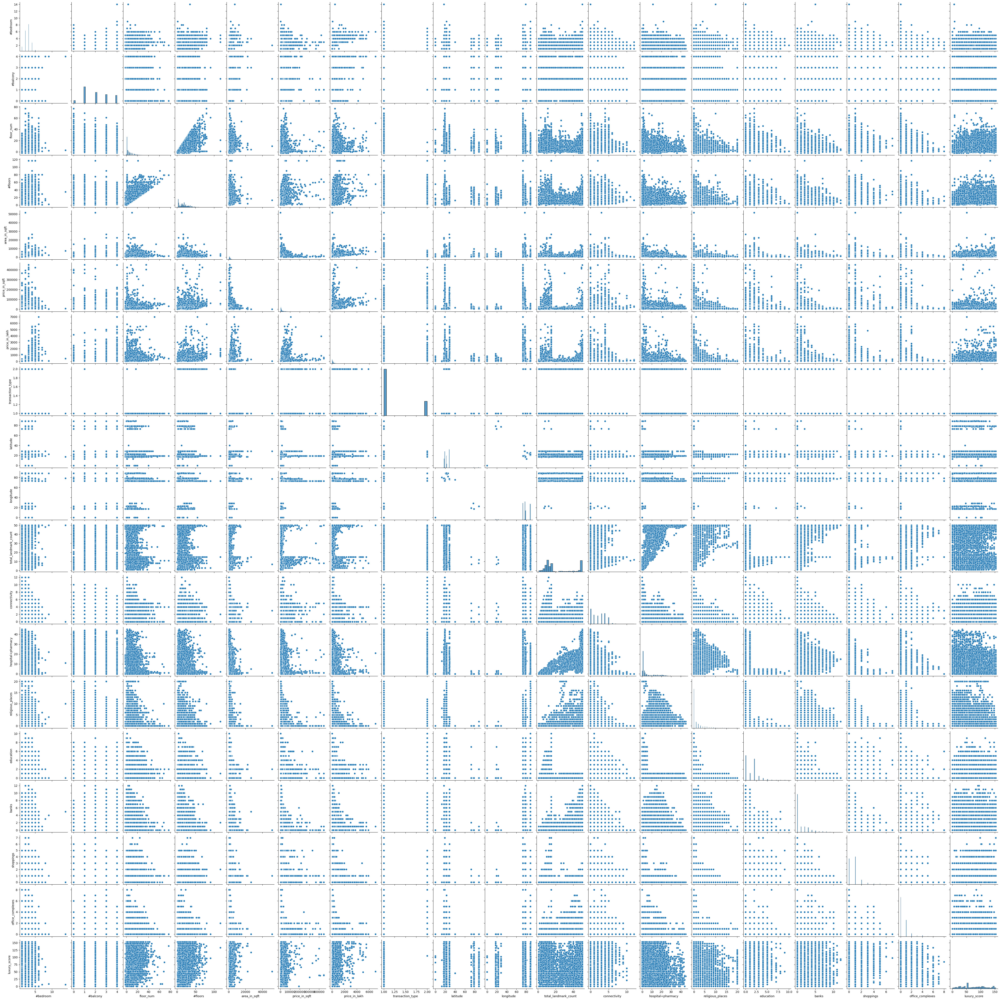

In [8]:
sns.pairplot(df)

In [18]:
temp = (df['price_in_lakh']*100000)/df['area_in_sqft']
temp.describe()

count     21922.000000
mean      13530.849834
std       11929.573634
min          93.100840
25%        6093.710841
50%        9669.489319
75%       16421.947450
max      258823.529412
dtype: float64

In [17]:
df.price_in_sqft.describe()

count     21922.000000
mean      14874.158334
std       18643.288447
min          93.000000
25%        6176.250000
50%       10000.000000
75%       17105.000000
max      449526.000000
Name: price_in_sqft, dtype: float64

# **Correlation**

In [19]:
df.describe()

,#bedroom,#balcony,floor_num,#floors,area_in_sqft,price_in_sqft,price_in_lakh,transaction_type,latitude,longitude,total_landmark_count,connectivity,hospital+pharmacy,religious_places,education,banks,shoppings,office_complexes,luxury_score
count,21910.000000,16747.000000,21922.000000,21922.000000,21922.000000,21922.000000,21922.000000,21916.000000,21922.000000,21922.000000,21443.000000,21922.000000,21922.000000,21922.000000,21922.000000,21922.000000,21922.000000,21922.000000,16453.000000
mean,2.699270,2.060966,6.302482,18.928382,1582.649621,14874.158334,222.856513,1.235627,23.575983,78.062396,22.001819,2.299106,6.178816,1.490649,1.309187,1.156236,0.781224,0.514004,74.483742
std,0.869543,1.203541,6.890335,13.623164,1166.181989,18643.288447,328.109817,0.424400,8.665476,9.751105,16.603744,1.844779,8.233337,3.052127,1.365444,1.953241,0.918283,0.887705,41.932134
min,1.000000,0.000000,-2.000000,0.000000,90.000000,93.000000,5.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.000000,1.000000,1.000000,7.000000,900.000000,6176.250000,70.000000,1.000000,19.079790,73.076837,10.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,43.000000
50%,3.000000,2.000000,4.000000,17.000000,1335.000000,10000.000000,140.000000,1.000000,22.500000,77.065294,14.000000,2.000000,2.000000,0.000000,1.000000,0.000000,1.000000,0.000000,72.000000
75%,3.000000,3.000000,9.000000,26.000000,1950.000000,17105.000000,250.000000,1.000000,28.395651,88.297874,41.000000,4.000000,10.000000,2.000000,2.000000,2.000000,1.000000,1.000000,108.000000
max,14.000000,4.000000,77.000000,117.000000,51557.000000,449526.000000,7000.000000,2.000000,88.491741,88.609395,50.000000,12.000000,45.000000,20.000000,10.000000,12.000000,7.000000,8.000000,153.000000


In [23]:
df.corr(numeric_only=bool)

,#bedroom,#balcony,floor_num,#floors,area_in_sqft,price_in_sqft,price_in_lakh,transaction_type,latitude,longitude,total_landmark_count,connectivity,hospital+pharmacy,religious_places,education,banks,shoppings,office_complexes,luxury_score
#bedroom,1.000000,0.437752,0.215668,0.193638,0.638496,0.081174,0.476323,-0.113897,0.120783,0.049624,-0.100715,0.136584,-0.166348,-0.109822,0.081859,-0.027912,0.071284,0.063625,0.241461
#balcony,0.437752,1.000000,0.167069,0.258642,0.429434,0.035091,0.266766,-0.006815,0.210327,-0.125217,-0.321931,0.262087,-0.309385,-0.277145,0.273778,-0.177101,0.191801,0.048922,0.382403
floor_num,0.215668,0.167069,1.000000,0.362002,0.313679,0.037911,0.212997,-0.427054,0.086348,-0.067943,-0.118186,0.075669,-0.134221,-0.119486,0.094922,-0.083681,0.046869,0.066278,0.291079
#floors,0.193638,0.258642,0.362002,1.000000,0.176331,0.407476,0.386041,0.299587,-0.071715,-0.210201,-0.331125,0.268492,-0.292346,-0.292112,0.320983,-0.271327,0.301092,0.047616,0.408709
area_in_sqft,0.638496,0.429434,0.313679,0.176331,1.000000,0.029715,0.566512,-0.238919,0.144556,-0.016174,-0.095017,0.107731,-0.152877,-0.113483,0.073612,-0.036423,0.027217,0.061124,0.260496
price_in_sqft,0.081174,0.035091,0.037911,0.407476,0.029715,1.000000,0.442904,0.270036,-0.105868,-0.190525,-0.051377,0.115472,-0.026553,-0.116404,0.125395,-0.124546,0.139621,-0.014156,0.129743
price_in_lakh,0.476323,0.266766,0.212997,0.386041,0.566512,0.442904,1.000000,0.034532,0.017805,-0.117868,-0.072276,0.128179,-0.086478,-0.133811,0.119714,-0.086146,0.070175,0.007689,0.215693
transaction_type,-0.113897,-0.006815,-0.427054,0.299587,-0.238919,0.270036,0.034532,1.000000,-0.237855,-0.061968,-0.203117,0.188082,-0.127842,-0.154179,0.216504,-0.181681,0.227663,-0.060439,0.005672
latitude,0.120783,0.210327,0.086348,-0.071715,0.144556,-0.105868,0.017805,-0.237855,1.000000,-0.633631,-0.274138,-0.024108,-0.207689,-0.157457,-0.019773,-0.125538,-0.049979,-0.019156,0.118091
longitude,0.049624,-0.125217,-0.067943,-0.210201,-0.016174,-0.190525,-0.117868,-0.061968,-0.633631,1.000000,0.133773,0.084235,0.127910,0.198501,-0.002774,0.188547,-0.016061,0.121544,-0.130548


<Axes: >

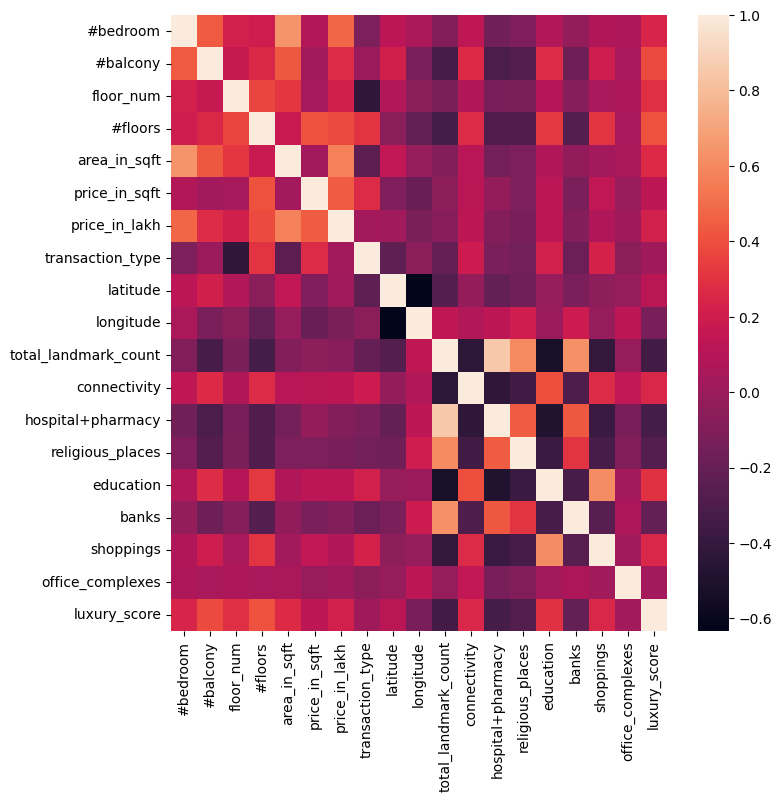

In [25]:
plt.figure(figsize=(8,8))
sns.heatmap(df.corr(numeric_only=bool))

In [27]:
df.corr(numeric_only=bool)['price_in_lakh'].sort_values(ascending=False)

price_in_lakh           1.000000
area_in_sqft            0.566512
#bedroom                0.476323
price_in_sqft           0.442904
#floors                 0.386041
#balcony                0.266766
luxury_score            0.215693
floor_num               0.212997
connectivity            0.128179
education               0.119714
shoppings               0.070175
transaction_type        0.034532
latitude                0.017805
office_complexes        0.007689
total_landmark_count   -0.072276
banks                  -0.086146
hospital+pharmacy      -0.086478
longitude              -0.117868
religious_places       -0.133811
Name: price_in_lakh, dtype: float64